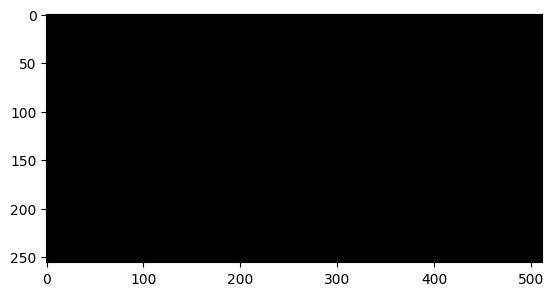

In [ ]:
import matplotlib.pyplot as plt
import torch

h, w = 256, 512
ph = [[[0] * w for _ in range(h)] for _ in range(3)]
torch_ph = torch.Tensor(ph).to(torch.uint8)
plt.imshow(torch_ph.permute(1, 2, 0))

In [ ]:
import torchvision
import torchvision.transforms.v2

In [ ]:
import math
import numbers
import warnings
from typing import Any, Callable, Dict, List, Literal, Optional, Sequence, Tuple, Type, Union

import PIL.Image
import torch

from torchvision import transforms as _transforms
from torchvision.transforms.v2 import functional as F, InterpolationMode, Transform
from torchvision.transforms.v2._utils import _setup_size, query_size

class TFInceptionCrop(Transform):

    def __init__(
        self,
        size: Union[int, Sequence[int]],
        scale: Tuple[float, float] = (0.08, 1.0),
        ratio: Tuple[float, float] = (3.0 / 4.0, 4.0 / 3.0),
        interpolation: Union[InterpolationMode, int] = InterpolationMode.BILINEAR,
        antialias: Optional[bool] = True,
        max_attempts: int = 100,
    ) -> None:
        super().__init__()
        self.size = _setup_size(size, error_msg="Please provide only two dimensions (h, w) for size.")

        if not isinstance(scale, Sequence):
            raise TypeError("Scale should be a sequence")
        if not isinstance(ratio, Sequence):
            raise TypeError("Ratio should be a sequence")
        if (scale[0] > scale[1]) or (ratio[0] > ratio[1]):
            warnings.warn("Scale and ratio should be of kind (min, max)")

        self.scale = scale
        self.ratio = ratio
        self.interpolation = interpolation
        self.antialias = antialias
        self.max_attempts = max_attempts

        self._ratio = torch.tensor(self.ratio)

    def _get_params(self, flat_inputs: List[Any]) -> Dict[str, Any]:
        """Almost line-by-line translation of the core logic of
        tensorflow/core/kernels/image/sample_distorted_bounding_box_op.cc
        """
        original_height, original_width = query_size(flat_inputs)
        area = original_height * original_width

        ratio = self._ratio
        for _ in range(self.max_attempts):
            aspect_ratio = torch.empty(1).uniform_(
                ratio[0],  # type: ignore[arg-type]
                ratio[1],  # type: ignore[arg-type]
            ).item()

            min_area = self.scale[0] * area
            max_area = self.scale[1] * area

            min_height = round(math.sqrt(min_area / aspect_ratio))
            max_height = round(math.sqrt(max_area / aspect_ratio))

            # TODO(b/140767341): Rewrite the generation logic to be more tolerant
            # of floating point behavior.
            if round(max_height * aspect_ratio) > original_width:
                # We must find the smallest max_height satisfying
                # round(max_height * aspect_ratio) <= original_width:
                EPSILON = 0.0000001
                max_height = int((original_width + 0.5 - EPSILON) / aspect_ratio)
                # If due some precision issues, we still cannot guarantee
                # round(max_height * aspect_ratio) <= original_width, subtract 1 from
                # max height.
                if round(max_height * aspect_ratio) > original_width:
                    max_height -= 1

            max_height = min(max_height, original_height)
            min_height = min(min_height, max_height)

            # We need to generate a random number in the closed range
            # [min_height, max_height].
            height = torch.randint(min_height, max_height + 1, size=(1,)).item()
            width = round(height * aspect_ratio)

            # Let us not fail if rounding error causes the area to be
            # outside the constraints.
            # Try first with a slightly bigger rectangle first.
            area = width * height
            if area < min_area:
                height += 1
                width = round(height * aspect_ratio)
                area = width * height

            # Let us not fail if rounding error causes the area to be
            # outside the constraints.
            # Try first with a slightly smaller rectangle first.
            if area > max_area:
                height -= 1
                width = round(height * aspect_ratio)
                area = width * height

            # Now, we explored all options to rectify small rounding errors.
            # If the constraints can be satisfied: break out of the loop.
            if 0 < width <= original_width and 0 < height <= original_height and min_area <= area <= max_area:
                i = torch.randint(0, original_height - height + 1, size=(1,)).item()
                j = torch.randint(0, original_width - width + 1, size=(1,)).item()
                break
        else:
            # Fallback to the entire image
            width = original_width
            height = original_height
            i = j = 0

        return dict(top=i, left=j, height=height, width=width)

    def _transform(self, inpt: Any, params: Dict[str, Any]) -> Any:
        return self._call_kernel(
            F.resized_crop, inpt, **params, size=self.size, interpolation=self.interpolation, antialias=self.antialias
        )

In [ ]:
TFInceptionCrop.get_params(torch_ph, scale=(0.05, 1.0), ratio=(3/4, 4/3))

AttributeError: type object 'TFInceptionCrop' has no attribute 'get_params'

In [ ]:
torch_repo_crop = TFInceptionCrop(224, scale=(0.05, 1.0), ratio=(3/4, 4/3))
torch_repo_crop._get_params(torch_ph)

{'top': 55, 'left': 289, 'height': 86, 'width': 81}

In [ ]:
import tqdm

In [ ]:
h, w = 256, 512
torch_repo_ij_counts = [[0] * w for _ in range(h)]
torch_repo_hw_counts = [[0] * (w + 1) for _ in range(h + 1)]
N = 100000
for _ in tqdm.tqdm(range(N)):
  i, j, h, w = torch_repo_crop._get_params(torch_ph).values()
  torch_repo_ij_counts[i][j] += 1
  torch_repo_hw_counts[h][w] += 1

100%|██████████| 100000/100000 [00:08<00:00, 12108.78it/s]


25
[[5898.24, 9175.04, 8519.68, 5898.24, 5242.88, 9830.4, 12451.84, 5242.88, 7208.96, 7864.32, 6553.6, 1966.08, 6553.6, 3932.16, 5898.24, 9175.04, 7864.32, 5242.88, 7208.96, 12451.84, 8519.68, 8519.68, 6553.6, 9830.4, 5898.24, 9175.04, 9830.4, 13762.56, 3932.16, 9175.04, 5242.88, 9175.04, 12451.84, 7864.32, 10485.76, 7864.32, 10485.76, 9175.04, 5242.88, 4587.52, 15073.28, 7864.32, 10485.76, 7864.32, 7208.96, 6553.6, 8519.68, 6553.6, 7208.96, 8519.68, 9830.4, 5242.88, 5898.24, 7864.32, 7208.96, 10485.76, 3276.8, 7208.96, 5242.88, 5242.88, 5898.24, 11141.12, 9175.04, 4587.52, 5898.24, 7864.32, 2621.44, 9175.04, 7864.32, 7208.96, 10485.76, 5898.24, 5242.88, 9830.4, 5242.88, 5898.24, 11141.12, 11796.48, 9830.4, 6553.6, 5242.88, 2621.44, 11796.48, 7864.32, 4587.52, 7208.96, 7864.32, 7208.96, 11796.48, 4587.52, 6553.6, 9830.4, 6553.6, 7208.96, 14417.92, 9175.04, 4587.52, 9830.4, 6553.6, 8519.68, 7208.96, 7864.32, 7208.96, 11796.48, 7864.32, 5898.24, 12451.84, 8519.68, 9830.4, 9175.04, 4587.5

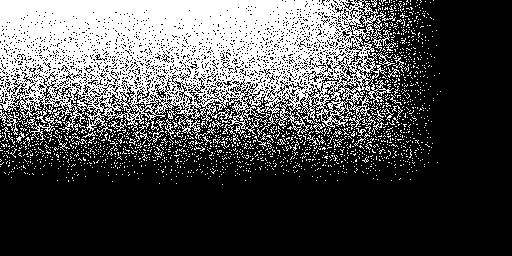

In [ ]:
from PIL import Image
import numpy as np

def plot(counts, factor=255):
  h, w = len(counts), len(counts[0])
  maximum = max(max(row) for row in counts)
  print(maximum)
  b = [[float(counts[i][j]) / maximum * factor for j in range(w)] for i in range(h)]
  print(b)
  return Image.fromarray(np.array(b)).convert('L')

plot(torch_repo_ij_counts, 16384)

36
[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 

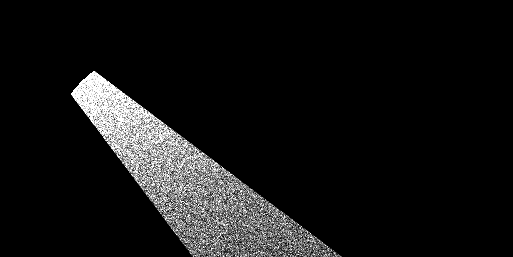

In [ ]:
plot(torch_repo_hw_counts, 1024)

In [ ]:
torchvision.transforms.v2.RandomResizedCrop.get_params(torch_ph, scale=(0.05, 1.0), ratio=(3/4, 4/3))

(63, 38, 104, 111)

In [ ]:
torch_ij_counts = [[0] * w for _ in range(h)]
torch_hw_counts = [[0] * (w + 1) for _ in range(h + 1)]
N = 100000
for _ in tqdm.tqdm(range(N)):
  i, j, h, w = torchvision.transforms.v2.RandomResizedCrop.get_params(torch_ph, scale=(0.05, 1.0), ratio=(3/4, 4/3))
  torch_ij_counts[i][j] += 1
  torch_hw_counts[h][w] += 1

100%|██████████| 100000/100000 [00:08<00:00, 11718.71it/s]


166
[[1184.3855421686746, 1480.4819277108434, 1184.3855421686746, 1875.2771084337348, 1776.578313253012, 1677.879518072289, 1677.879518072289, 1973.9759036144578, 1579.1807228915663, 1480.4819277108434, 1480.4819277108434, 2072.6746987951806, 1973.9759036144578, 1579.1807228915663, 2171.373493975904, 1973.9759036144578, 1677.879518072289, 2467.4698795180725, 1973.9759036144578, 2171.373493975904, 1875.2771084337348, 1283.0843373493976, 1973.9759036144578, 1677.879518072289, 1085.686746987952, 1381.7831325301204, 2368.7710843373493, 1973.9759036144578, 2368.7710843373493, 1184.3855421686746, 1184.3855421686746, 2072.6746987951806, 1381.7831325301204, 2171.373493975904, 1381.7831325301204, 2270.0722891566265, 1480.4819277108434, 1677.879518072289, 1283.0843373493976, 2270.0722891566265, 2368.7710843373493, 1776.578313253012, 1184.3855421686746, 1381.7831325301204, 1973.9759036144578, 1184.3855421686746, 1776.578313253012, 1283.0843373493976, 2368.7710843373493, 1875.2771084337348, 1184.3

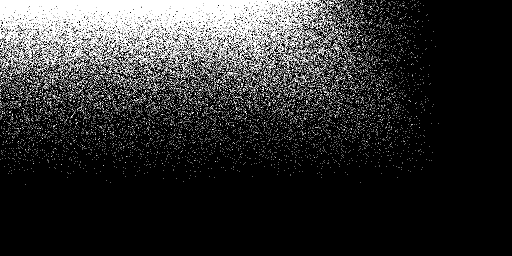

In [ ]:
plot(torch_ij_counts, 16384)

151
[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,

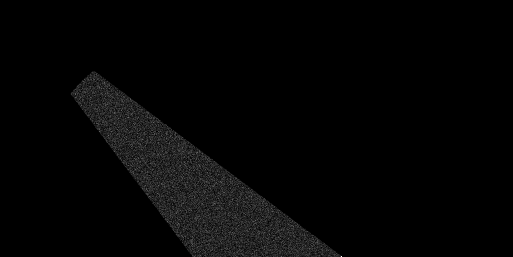

In [ ]:
plot(torch_hw_counts, 1024)

151
[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,

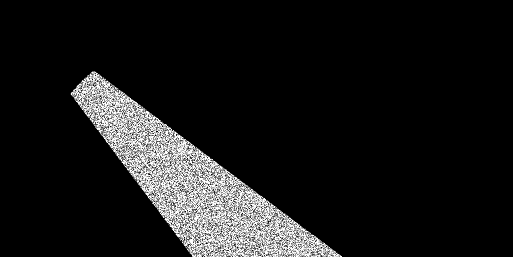

In [ ]:
plot(torch_hw_counts, 5120)

In [ ]:
import tensorflow as tf
h, w = 256, 512
N = 100000
tf_ij_counts = [[0] * w for _ in range(h)]
tf_hw_counts = [[0] * (w + 1) for _ in range(h + 1)]
for _ in tqdm.tqdm(range(N)):
  begin, crop_size, _ = tf.image.sample_distorted_bounding_box(
        tf.convert_to_tensor([h, w, 1]),
        tf.zeros([0, 0, 4], tf.float32),
        area_range=[0.05, 1],
        min_object_covered=0,  # Don't enforce a minimum area.
        use_image_if_no_bounding_boxes=True)
  i, j, _ = begin.numpy()
  y, x, _ = crop_size.numpy()
  tf_ij_counts[i][j] += 1
  tf_hw_counts[y][x] += 1

100%|██████████| 100000/100000 [00:36<00:00, 2737.55it/s]


32
[[5632.0, 7168.0, 4608.0, 5632.0, 7680.0, 10240.0, 8192.0, 6656.0, 11264.0, 5632.0, 10240.0, 9216.0, 7168.0, 7680.0, 5120.0, 6656.0, 4096.0, 9728.0, 8192.0, 7680.0, 4608.0, 9216.0, 8192.0, 9216.0, 4608.0, 9728.0, 6656.0, 5632.0, 7680.0, 4608.0, 7680.0, 6656.0, 8704.0, 9728.0, 9728.0, 12288.0, 6656.0, 7680.0, 9728.0, 6144.0, 6656.0, 6144.0, 10752.0, 5120.0, 8192.0, 6656.0, 7680.0, 7168.0, 8192.0, 8704.0, 8192.0, 6656.0, 3584.0, 12288.0, 4096.0, 6144.0, 12288.0, 7168.0, 9216.0, 4096.0, 3072.0, 7680.0, 8192.0, 9728.0, 6656.0, 10752.0, 4096.0, 9216.0, 6144.0, 10240.0, 10240.0, 6656.0, 7680.0, 16384.0, 9216.0, 6144.0, 5120.0, 7168.0, 7168.0, 7168.0, 8704.0, 7168.0, 6656.0, 5120.0, 8704.0, 13824.0, 4096.0, 6144.0, 9216.0, 7168.0, 6656.0, 7168.0, 4608.0, 6656.0, 7680.0, 9216.0, 4608.0, 12800.0, 5632.0, 5632.0, 7680.0, 6144.0, 6144.0, 9216.0, 7680.0, 6656.0, 10240.0, 8704.0, 7680.0, 8704.0, 8192.0, 5632.0, 6656.0, 5632.0, 8704.0, 8704.0, 8192.0, 8192.0, 4096.0, 5120.0, 5632.0, 7680.0, 6144.

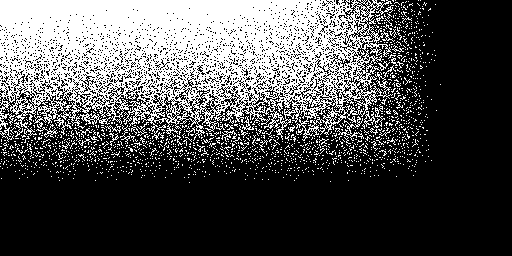

In [ ]:
plot(tf_ij_counts, 16384)

32
[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 

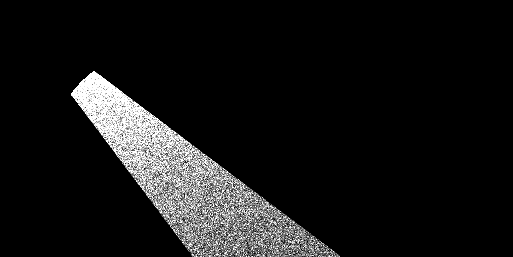

In [ ]:
plot(tf_hw_counts, 1024)

In [ ]:
torch_repo_ij_counts, torch_repo_hw_counts

([[9,
   14,
   13,
   9,
   8,
   15,
   19,
   8,
   11,
   12,
   10,
   3,
   10,
   6,
   9,
   14,
   12,
   8,
   11,
   19,
   13,
   13,
   10,
   15,
   9,
   14,
   15,
   21,
   6,
   14,
   8,
   14,
   19,
   12,
   16,
   12,
   16,
   14,
   8,
   7,
   23,
   12,
   16,
   12,
   11,
   10,
   13,
   10,
   11,
   13,
   15,
   8,
   9,
   12,
   11,
   16,
   5,
   11,
   8,
   8,
   9,
   17,
   14,
   7,
   9,
   12,
   4,
   14,
   12,
   11,
   16,
   9,
   8,
   15,
   8,
   9,
   17,
   18,
   15,
   10,
   8,
   4,
   18,
   12,
   7,
   11,
   12,
   11,
   18,
   7,
   10,
   15,
   10,
   11,
   22,
   14,
   7,
   15,
   10,
   13,
   11,
   12,
   11,
   18,
   12,
   9,
   19,
   13,
   15,
   14,
   7,
   10,
   21,
   9,
   12,
   10,
   16,
   8,
   17,
   8,
   10,
   11,
   13,
   6,
   9,
   8,
   8,
   14,
   12,
   12,
   10,
   11,
   14,
   15,
   13,
   13,
   10,
   17,
   12,
   9,
   17,
   10,
   8,
   17,
   7,
   12,
   6,
   25,
   15,
 

In [ ]:
torch_ij_counts, torch_hw_counts

([[12,
   15,
   12,
   19,
   18,
   17,
   17,
   20,
   16,
   15,
   15,
   21,
   20,
   16,
   22,
   20,
   17,
   25,
   20,
   22,
   19,
   13,
   20,
   17,
   11,
   14,
   24,
   20,
   24,
   12,
   12,
   21,
   14,
   22,
   14,
   23,
   15,
   17,
   13,
   23,
   24,
   18,
   12,
   14,
   20,
   12,
   18,
   13,
   24,
   19,
   12,
   14,
   15,
   11,
   15,
   20,
   16,
   17,
   15,
   31,
   12,
   14,
   20,
   15,
   25,
   16,
   19,
   9,
   15,
   14,
   21,
   22,
   18,
   22,
   16,
   16,
   21,
   14,
   24,
   16,
   20,
   17,
   21,
   21,
   18,
   166,
   13,
   12,
   17,
   8,
   19,
   13,
   18,
   11,
   21,
   11,
   19,
   15,
   17,
   21,
   18,
   13,
   17,
   14,
   13,
   17,
   11,
   15,
   17,
   11,
   20,
   13,
   17,
   21,
   17,
   14,
   20,
   23,
   17,
   14,
   11,
   13,
   17,
   16,
   13,
   19,
   16,
   13,
   15,
   20,
   15,
   20,
   14,
   17,
   12,
   16,
   13,
   17,
   17,
   14,
   16,
   16,
   10,


In [ ]:
tf_ij_counts, tf_hw_counts

([[11,
   14,
   9,
   11,
   15,
   20,
   16,
   13,
   22,
   11,
   20,
   18,
   14,
   15,
   10,
   13,
   8,
   19,
   16,
   15,
   9,
   18,
   16,
   18,
   9,
   19,
   13,
   11,
   15,
   9,
   15,
   13,
   17,
   19,
   19,
   24,
   13,
   15,
   19,
   12,
   13,
   12,
   21,
   10,
   16,
   13,
   15,
   14,
   16,
   17,
   16,
   13,
   7,
   24,
   8,
   12,
   24,
   14,
   18,
   8,
   6,
   15,
   16,
   19,
   13,
   21,
   8,
   18,
   12,
   20,
   20,
   13,
   15,
   32,
   18,
   12,
   10,
   14,
   14,
   14,
   17,
   14,
   13,
   10,
   17,
   27,
   8,
   12,
   18,
   14,
   13,
   14,
   9,
   13,
   15,
   18,
   9,
   25,
   11,
   11,
   15,
   12,
   12,
   18,
   15,
   13,
   20,
   17,
   15,
   17,
   16,
   11,
   13,
   11,
   17,
   17,
   16,
   16,
   8,
   10,
   11,
   15,
   12,
   18,
   20,
   11,
   15,
   19,
   14,
   13,
   14,
   15,
   17,
   17,
   17,
   14,
   12,
   22,
   16,
   17,
   14,
   14,
   10,
   8,
   12,
